In [1]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, ShuffleSplit, cross_val_score, learning_curve
from sklearn.model_selection import StratifiedKFold, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import classification_report, f1_score, precision_score, recall_score

from sklearn.svm import SVC

import json
from pprint import pprint
import pandas as pd
import os
import re
import time
import matplotlib.pyplot as plt
%matplotlib inline
import math
import warnings
import numpy as np
import pandas as pd
import seaborn as sns

import pickle
import random
from pathlib import Path
import catboost as catb
from catboost import CatBoostClassifier
from pathlib import Path
from transliterate import translit

In [2]:
ds = pd.read_json('2606.json')

In [20]:
data = ds.copy()
data.columns

Index(['_id', 'name_store', 'main_category_name', 'main_category_img_url',
       'category_name', 'category_img_url', 'category_permalink',
       'product_name', 'product_img_link', 'product_instamart_price',
       'product_original_unit_price', 'product_price', 'product_human_volume',
       'product_items_per_pack', 'product_price_type', 'product_stock',
       'product_stock_rate', 'product_max_stock_rate', 'product_discounted',
       'product_discount', 'product_unit_price', 'product_description',
       'product_description_original', 'product_properties'],
      dtype='object')

In [4]:
# Поиск значимых свойств
def type_prod(x):
    try:
        return x['product_information']['Тип продукта']
    except:
        try:
            return x['product_information']['Тип изделия']
        except:
            try:
                return (x['product_information']['Вид воды'])
            except:
                try:
                    return x['product_information']['Тип средства']
                except:
                    try:
                        return x['product_information']['Тип']
                    except:
                        try:
                            return x['product_information']['Вид каши']
                        except:
                             try:
                                return x['product_information']['Назначение']
                             except:
                                try:
                                    return x['product_information']['Технология']
                                except:
                                    try:
                                        return x['product_information']['Разновидность']
                                    except:
                                        try:
                                            return x['product_information']['Действующее вещество']
                                        except:
                                            try:
                                                return x['product_information']['Вид готового блюда']
                                            except:
                                                try:
                                                    return x['product_information']['Вид']
                                                except:
                                                    try:
                                                        return x['product_information']['Вид товара']
                                                    except:
                                                        try:
                                                            return x['product_information']['Тип товара']
                                                        except:
                                                            try:
                                                                return x['product_information']['Пол']
                                                            except:
                                                                return '-'
#                                                                 print(x['product_information'])    

In [5]:
# Чтение словаря (список магазинов) из файла
with open('shops_dict', 'r') as f:
    shops_dict = json.loads(f.read())

In [6]:
#Запись словаря в файл    
with open('shops_dict', 'w', encoding='utf-8') as f:
    f.write(json.dumps(shops_dict))

In [7]:
def give_me_dataset(data):
    
    # regex for all nums and len(word)>3 -> new column product_group_name
    df = data.copy()
    df.loc[(df['product_price_type'] == 'per_kilo'), 'product_price'] = df['product_unit_price']
    df.loc[(df['product_price_type'] == 'per_kilo'), 'product_human_volume'] = '1 кг'
    df =  df[(df['main_category_name'] != 'Алкоголь')]
    
    # Создание колонки для группировки продуктов
    
    df.reset_index(inplace=True)
    
    re1 = r"\d+" # nums
    re2 = '\w{3,30}' # words (цифры , буквы и др символы)
    re11 = '[a-zа-яё]+\d+|\d+[a-zа-яё]+|\d+\,*\d+\%|\w[а-яё,a-z]{2,30}' #буквы, цифры с буквами   #'\w[а-яё,a-z]{2,30}\d*'   # words
    re3 = r"\d+\s\b[млкгшт]{1,2}\b|\d+\,*\d+\s\b[млкгшт]{1,2}" 
    
    list_of_names = []
    list_of_names_orig = []
    for num, i in enumerate(df.product_name): 
        try:
            weight = re.findall(re3, df.product_human_volume[num])[0].split()
            if (weight[0] == '1' and weight[1] == 'шт'):
                name = ' '.join(sorted(re.compile("(%s)" % re2).findall(i.lower())))
                name_orig = df.product_name[num].lower()              
            else:
                name = str(weight[0]) + ' ' + ' '.join(sorted(re.compile("(%s)" % re11).findall(i.lower()))) 
                name_orig = str(weight[0]) + ' ' + ' '.join(re.compile("(%s)" % re11).findall(i.lower()))
        except:
            name = ' '.join(sorted(re.compile("(%s)" % re11).findall(i.lower())))
            name_orig = ' '.join(re.compile("(%s)" % re11).findall(i.lower()))

        list_of_names.append(name)
        list_of_names_orig.append(name_orig)
    df.insert(loc=0, column='product_group_name', value=list_of_names) 
    df.insert(loc=0, column='product_group_name_orig', value=list_of_names_orig) 
    df['product_group_name'] = df['product_group_name'].apply(lambda x: x.replace(' metro chef', ''))
    df['product_group_name'] = df['product_group_name'].apply(lambda x: x.replace(' бзмж', ''))
    df['product_group_name_orig'] = df['product_group_name_orig'].apply(lambda x: x.replace(' metro chef', ''))
    df['product_group_name_orig'] = df['product_group_name_orig'].apply(lambda x: x.replace(' бзмж', '')) 
        
       
    # delete duplicates in each shop and make clear_dataset  

    clear_dataset = pd.DataFrame() 
    for shop in df['name_store'].unique():
        df_temp = df[df['name_store'] == shop]
        df_temp.drop_duplicates(subset='product_group_name', inplace=True)
        try:
            df_temp.loc[df_temp['name_store'] == shop, 'name_store'] = shops_dict.get(shop, [])
        except:
            print(shop, ' - new shop!')
            
        
        clear_dataset = pd.concat([clear_dataset, df_temp]) 
            
    return clear_dataset

In [22]:
%%time
new_df = give_me_dataset(data)

Wall time: 11.1 s


## Преобработка текста для обучения модели

In [23]:
def lower(x):
    a = str(x).lower()
    return a

In [24]:
def preprocess_data(df):
    short_names = []    
    df['manufacturer'] = df['product_properties'].apply(lambda x: (x['product_information']['manufacturer']))
    df['brand'] = df['product_properties'].apply(lambda x:  lower((x['product_information']['brand'])))
    df['properties'] = df['product_properties'].apply(lambda x: lower(type_prod(x)))
    df['product_name_prep_short'] = df['product_name']
    for i, j in zip(df.product_name, df.brand):
        short_name = str(i).lower().replace(str(j), '')
        short_names.append(short_name)
    df['product_name_prep_short'] = short_names
    return df

In [25]:
new_df = preprocess_data(new_df) 

In [26]:
new_df[['product_name_prep_short', 'product_name', 'brand']]

,product_name_prep_short,product_name,brand
0,петрушка,Петрушка,без бренда
1,петрушка в горшочке 120 г,Петрушка в горшочке 120 г,без бренда
2,петрушка 100 г,Петрушка 100 г,без бренда
3,плавленый сыр чизбургер 8 ломтиков 45% 150 г,Плавленый сыр Hochland Чизбургер 8 ломтиков 45...,hochland
4,помидоры черри желтые круглые без ветки 250 г,Помидоры черри Мое Лето желтые круглые без вет...,мое лето
...,...,...,...
134973,семечки подсолнечные отборные жареные 100 г,Семечки подсолнечные От Мартина Отборные жарен...,от мартина
134974,семечки подсолнечные молодежные жареные 100 г,Семечки подсолнечные От Мартина Молодежные жар...,от мартина
134975,изюм без косточки 70 г,Изюм Первым делом без косточки 70 г,первым делом
134976,финики сушеные 200 г,Финики сушеные 200 г,без бренда


In [27]:
colors = set(['красный', 'оранжевый', 'желтый', 'зеленый', 'синий', 'фиолетовый', 'голубой', 'розовый', 'бежевый', 'серый', 'коричневый', 'сиреневый'])

In [28]:
from string import punctuation
from stop_words import get_stop_words
from pymorphy2 import MorphAnalyzer


sw = set(get_stop_words("ru"))
exclude = set(punctuation)
morpher = MorphAnalyzer()



def preprocess_prod_name(txt):
     
    re1 = '[a-zа-яё]+\d+|\d+[a-zа-яё]+|\d+\,*\d+\%|\w[а-яё,a-z]{2,30}' #буквы, цифры с буквами
    txt = str(txt)
    txt = re.sub("[^а-яА-Яa-zA-Z\-\_Ёё]"," ",txt) 
    # удаляем лишние пробелы
    txt = ' '.join(txt.split())
    # приводим к нижнему регистру и удаляем лишние символы
    txt = ' '.join(re.compile("(%s)" % re1).findall(txt.lower()))
    txt = "".join(c for c in txt if c not in exclude)
    txt = "".join(c for c in txt if c not in colors)
    txt = [morpher.parse(word)[0].normal_form for word in txt.split() if word not in sw]
    return " ".join(txt)

new_df['product_name_prep'] = new_df['product_name_prep_short'].apply(preprocess_prod_name)
new_df['product_name_prep'] = new_df['product_name_prep'].apply(lambda x: x.replace(' бзмж', '').replace(' metro chef', ''))

In [29]:
new_df[['product_name','product_name_prep']]

,product_name,product_name_prep
0,Петрушка,петрушка
1,Петрушка в горшочке 120 г,петрушка горшочек
2,Петрушка 100 г,петрушка
3,Плавленый сыр Hochland Чизбургер 8 ломтиков 45...,плавленый сыр чизбургер ломтик
4,Помидоры черри Мое Лето желтые круглые без вет...,помидор черри жёлтый круглый ветка
...,...,...
134973,Семечки подсолнечные От Мартина Отборные жарен...,семечко подсолнечный отборный жареный
134974,Семечки подсолнечные От Мартина Молодежные жар...,семечко подсолнечный молодёжный жареный
134975,Изюм Первым делом без косточки 70 г,изюм косточка
134976,Финики сушеные 200 г,финик сушёный


In [30]:
# до обработки
len(new_df['product_name'].unique())

99803

In [31]:
# После обработки
len(new_df['product_name_prep'].unique())

79706

# EDA 
## Изучение категорий товаров

In [32]:
def print_main_cat_dict(df):
    category = df['main_category_name'].unique()
    dict = {}
    for name in category:
        dict[name] = (df.loc[new_df['main_category_name'] == name, 'category_name'].unique().tolist())
    pprint(dict)

In [33]:
new_df['name_store'].value_counts()

Окей         27923
Глобус       27868
Ашан         23479
Лента        21508
Метро        15179
Виктория      7999
Дикси         3264
Магнит        3211
Фикспрайс     2108
Name: name_store, dtype: int64

In [34]:
df_gotov_eda = new_df.loc[new_df['main_category_name'] == 'Готовая еда']
len(df_gotov_eda)

664

In [35]:
df_zamoroz = new_df.loc[new_df['main_category_name'] == 'Замороженные продукты']
len(df_zamoroz)

2496

In [36]:
df_myaso = new_df.loc[new_df['main_category_name'] == 'Мясо, птица']
len(df_myaso)

665

In [37]:
df_sport = new_df.loc[new_df['main_category_name'] == 'Спортивные товары']
len(df_sport)

543

In [38]:
shop = np.unique(new_df['name_store'].values)
for name in shop:
    print('Магазин - ', name, '\n\n', new_df.loc[new_df['name_store'] == name, 'main_category_name'].value_counts(), '\n\n')

Магазин -  Ашан 

 Дача, сад                                   2886
Рецепты                                     2735
Косметика, гигиена                          2469
Детские товары                              1453
Спецпредложения АШАН                        1391
Летний отдых, барбекю                       1328
Сладости                                    1241
Кухня                                        908
Товары для дома                              902
Бытовая химия, уборка                        780
Молоко, сыр, яйца, растительные продукты     743
Товары для животных                          678
Макароны, крупы, мука                        648
Канцелярия, книги                            578
Бытовая техника, электроника                 535
Замороженные продукты                        450
Колбасы, сосиски, деликатесы                 424
Мелочи возле кассы                           398
Автотовары                                   363
Одежда, обувь, аксессуары                    348
К

In [16]:
# Стандартные импорты plotly
from chart_studio import plotly as py
# import graph_obs as go
from plotly.offline import iplot
import cufflinks as cf
cufflinks.go_offline()
# Устанавливаем глобальную тему
cf.set_config_file(world_readable=True, theme='pearl', offline=True)

In [19]:
new_df['main_category_name'].iplot(kind='hist', xTitle='Категории товаров',
                  yTitle='Количество', title='Распределение категорий')

Исходя из того, что в магазине Окей большой ассортимент и охватываются все категории товаров, то в качестве тренировочных были взяты данные из этого магазина

In [39]:
train = new_df.loc[new_df['name_store'] == 'Окей']

In [40]:
train = train[train['category_name'] != 'Продукты с бесплатной доставкой']

Для того, чтобы создать качественный обучающий датасет, категории и подкатегории товаров из магазина Окей были пересмотрены, отредактированы  и собраны в словарь 

In [41]:
# Чтение словаря из файла
with open('train_dict', 'r') as f:
    category_make_dict = json.loads(f.read())

In [42]:
def search_cat(name):
    for k in category_make_dict:
        if set(category_make_dict[k]) & {name}:
             return k

In [43]:
'''Проебразования категорий'''
def give_train_categories(df):
    sub_cat = df['category_name'].unique()
    for k in sub_cat:
        df.loc[df['category_name'] == k, 'category_name'] = ' '.join(k.split())
        search = search_cat(k)
        df.loc[df['category_name'] == k, 'main_category_name'] = search
    return df

In [44]:
df_train = give_train_categories(train)

In [45]:
df_train = pd.concat([df_train, df_gotov_eda, df_myaso, df_sport])

In [46]:
df_train['main_category_name'].value_counts()

Косметика, гигиена                                4368
Детские товары                                    2641
Канцелярия, книги                                 2171
Молочные продукты, яйца, растительные продукты    1639
Дача, сад                                         1493
Одежда, обувь, аксессуары                         1411
Сладости                                          1382
Товары для дома                                   1186
Кухня                                             1117
Бакалея                                           1000
Мясо, птица                                        918
Соусы и специи и приправы                          874
Готовая еда                                        830
Вода, соки, напитки                                801
Бытовая химия, уборка                              769
Чай, кофе, горячие напитки                         732
Замороженные продукты                              730
Колбасы, сосиски, деликатесы                       690
Бытовая те

In [47]:
df_train['main_category_name'].unique() 

array(['Всё для ремонта', 'Автотовары', 'Спортивные товары',
       'Канцелярия, книги', 'Одежда, обувь, аксессуары',
       'Бытовая техника, электроника', 'Дача, сад',
       'Чай, кофе, горячие напитки', 'Вода, соки, напитки',
       'Овощи, фрукты, зелень, орехи', 'Сладости', 'Косметика, гигиена',
       'Товары для дома', 'Кухня', 'Детские товары',
       'Товары для животных', 'Бытовая химия, уборка', 'Бакалея',
       'Соусы и специи и приправы',
       'Молочные продукты, яйца, растительные продукты',
       'Замороженные продукты', 'Консервы, соленья', 'Хлеб, выпечка',
       'Рыба, морепродукты, икра', 'Колбасы, сосиски, деликатесы',
       'Мясо, птица', 'Чипсы, снеки', 'Готовая еда'], dtype=object)

In [48]:
len(df_train['main_category_name'].unique()) == len(category_make_dict.keys())

True

In [49]:
with open(f'data/df_train_all.json', 'w', encoding='utf-8') as file:
    df_train.to_json(file, force_ascii=False,  orient='records')         

In [41]:
#Запись словарей в файл    
with open('train_dict', 'w', encoding='utf-8') as f:
    f.write(json.dumps(category_make_dict))

### СОЗДАНИЕ ПРИЗНАКОВ

In [50]:
# Чтение файла из папки
df_train = pd.read_json(f'data/df_train_all.json')

In [51]:
TARGET_NAME = ['main_category_name']
NUM_FEATURE_NAMES = []

CAT_FEATURE_NAMES = [
                     'first_prod_name',
                     'second_prod_name',
                     'last_name',
                     'brand',
                     'manufacturer',
                     'properties'
                    ] 


SELECTED_FEATURE_NAMES = NUM_FEATURE_NAMES + CAT_FEATURE_NAMES
print(SELECTED_FEATURE_NAMES)

['first_prod_name', 'second_prod_name', 'last_name', 'brand', 'manufacturer', 'properties']


In [52]:
# Создание новых признаков, предобработка данных
def preprocess_data(df):
#     df['product_name'] = df['product_name'].apply(lambda x: x.replace('metro chef ', ''))
    list_of_names = []
    last_name = []
    short_names = []
    df['last_name'] = df.product_name_prep.apply(lambda x: x.split()[-1] if len(x.split()) > 1 else '-')
    res = df['product_name_prep'].str.split(' ',expand=True).apply(lambda x: x.str.strip()).loc[:,:1]
    res.columns =  ['first_prod_name', 'second_prod_name']  
    df1 = df.join(res)
    df1.loc[df1['second_prod_name'].isna(), 'second_prod_name'] = '-'
    df1.loc[df1['first_prod_name'].isna(), 'first_prod_name'] = '-'
    df1.loc[df1['brand'].isna(), 'brand'] = 'без бренда'
    df1.loc[df1['manufacturer'].isna(), 'manufacturer'] = '-'
    df1.loc[df1['properties'].isna(), 'properties'] = '-'
    
    return df1[NUM_FEATURE_NAMES + TARGET_NAME + CAT_FEATURE_NAMES]

In [53]:
df_train = preprocess_data(df_train)

In [54]:
df_train

,main_category_name,first_prod_name,second_prod_name,last_name,brand,manufacturer,properties
0,Всё для ремонта,обезжириватель,очистка,раствор,krona,Химик ОАО,очистители
1,Всё для ремонта,трос,прочистка,труба,"то, что надо!",Окей ООО,тросы
2,Всё для ремонта,обезжириватель,-,-,krona,KRONA,растворители
3,Всё для ремонта,керосин,-,-,химик,Химик ОАО,растворители
4,Всё для ремонта,очки,защитный,прозрачный,fit,Технопласт ООО,очки
...,...,...,...,...,...,...,...
29774,Спортивные товары,очки,плавание,ассортимент,silapro,Yongkang Jinli Sports Equipment Factory,очки
29775,Спортивные товары,скакалка,скоростной,ассортимент,silapro,Галацентр,скакалки
29776,Спортивные товары,мяч,попрыгун,ассортимент,silapro,Юнкан Цзиньли Спортс Еквипмент Фэктори,гимнастические мячи
29777,Спортивные товары,батончик,карнитина,клубника,smartbar,СмартБар Групп ООО,карнитин


In [55]:
short_data = new_df.copy()
short_df = preprocess_data(short_data)

In [71]:
with open(f'data/short_df.csv', 'w', encoding='utf-8') as file:
            short_df.to_csv(file)

### Сохранение обучающего датасета

In [121]:
DATA_ROOT = Path('C:/Users/druzh/Desktop/data_scientist/SARAWAN/' )
MODELS_PATH = Path('C:/Users/druzh/Desktop/data_scientist/SARAWAN/models/')

# input
DATASET_PATH = DATA_ROOT / 'df_train_all.csv'
TEST_PATH = DATA_ROOT / 'df_test.csv'
PREP_DATASET_PATH = DATA_ROOT / 'df_short.csv'
# output
MODEL_FILE_PATH = MODELS_PATH / 'model_4_10_22.pkl'

In [122]:
df_train.to_csv(DATASET_PATH, index=False, encoding='utf-8')

In [490]:
short_df.to_csv(PREP_DATASET_PATH, index=False, encoding='utf-8')
new_df.to_csv(TEST_PATH, index=False, encoding='utf-8')

In [57]:
short_df = pd.read_csv(PREP_DATASET_PATH)

# Подготовка к обучению

In [58]:
def get_classification_report(y_train_true, y_train_pred, y_test_true, y_test_pred):
    print('TRAIN\n\n' + classification_report(y_train_true, y_train_pred))
    print('TEST\n\n' + classification_report(y_test_true, y_test_pred))

In [59]:
def evaluate_preds(model, X_train, X_test, y_train, y_test):
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    get_classification_report(y_train, y_train_pred, y_test, y_test_pred)

In [60]:
from pandas.api.types import is_numeric_dtype

### ОТБОР ПРИЗНАКОВ

In [61]:
TARGET_NAME = 'main_category_name'
NUM_FEATURE_NAMES = []

CAT_FEATURE_NAMES = [
                     'first_prod_name',
#                      'second_prod_name',
#                      'last_name',
                     'brand',
#                      'manufacturer',
                     'properties'
                    ] 


SELECTED_FEATURE_NAMES = NUM_FEATURE_NAMES + CAT_FEATURE_NAMES
print(SELECTED_FEATURE_NAMES)

['first_prod_name', 'brand', 'properties']


### Разбиение на train и test

In [62]:
X = df_train[SELECTED_FEATURE_NAMES]
y = df_train[TARGET_NAME]
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    shuffle=True,
                                                    test_size=0.25,
                                                    random_state=21,
                                                    stratify=y
                                                   )

display(y_train.value_counts(normalize=True), y_test.value_counts(normalize=True))

Косметика, гигиена                                0.146682
Детские товары                                    0.088699
Канцелярия, книги                                 0.072893
Молочные продукты, яйца, растительные продукты    0.055028
Дача, сад                                         0.050148
Одежда, обувь, аксессуары                         0.047372
Сладости                                          0.046387
Товары для дома                                   0.039805
Кухня                                             0.037521
Бакалея                                           0.033581
Мясо, птица                                       0.030805
Соусы и специи и приправы                         0.029327
Готовая еда                                       0.027850
Вода, соки, напитки                               0.026910
Бытовая химия, уборка                             0.025835
Чай, кофе, горячие напитки                        0.024581
Замороженные продукты                             0.0245

Косметика, гигиена                                0.146676
Детские товары                                    0.088650
Канцелярия, книги                                 0.072935
Молочные продукты, яйца, растительные продукты    0.055071
Дача, сад                                         0.050101
Одежда, обувь, аксессуары                         0.047414
Сладости                                          0.046474
Товары для дома                                   0.039893
Кухня                                             0.037475
Бакалея                                           0.033580
Мясо, птица                                       0.030893
Соусы и специи и приправы                         0.029416
Готовая еда                                       0.027938
Вода, соки, напитки                               0.026864
Бытовая химия, уборка                             0.025789
Чай, кофе, горячие напитки                        0.024580
Замороженные продукты                             0.0244

##  Подбор параметров модели по сетке

In [63]:
from catboost.eval.catboost_evaluation import *

In [68]:
def get_categorical_indicies(X):
    cat_indicies = []
    for col in CAT_FEATURE_NAMES:
        cat_indicies.append(X.columns.get_loc(col))
    return cat_indicies
categorical_indicies = get_categorical_indicies(X_train)

In [69]:
train_dataset = catb.Pool(X_train,y_train, 
                        cat_features=categorical_indicies)                                                      
test_dataset = catb.Pool(X_test,y_test,           
                       cat_features=categorical_indicies)

In [15]:
model_1 = catb.CatBoostClassifier(loss_function='MultiClass',
                                cat_features=CAT_FEATURE_NAMES,
                                early_stopping_rounds=20,
#                                 use_best_model=True,
                                custom_metric=['Precision', 'Recall', 'AUC'],  
                                eval_metric='Accuracy')

In [16]:
grid = {'learning_rate': [0.03, 0.05, 0.1],
        'depth': [4, 6, 10],
        'l2_leaf_reg': [1, 3, 5,],
        'iterations': [50, 100]}

In [ ]:
model_1.grid_search(grid,train_dataset)

In [22]:
print(model_1.best_score_)

{'learn': {'Recall:class=14': 0.9279907084785134, 'Recall:class=21': 0.9444444444444444, 'Recall:class=24': 0.961340206185567, 'Precision:class=8': 0.9014806378132119, 'Recall:class=3': 0.937037037037037, 'Precision:class=24': 0.9946666666666667, 'Recall:class=12': 0.8785871964679912, 'Recall:class=5': 0.7757847533632287, 'Recall:class=26': 0.9921875, 'Recall:class=9': 0.8864970645792564, 'Recall:class=19': 0.8872832369942196, 'Recall:class=2': 0.9489194499017681, 'Precision:class=18': 0.9975170701427685, 'Precision:class=26': 0.9960079840319361, 'Recall:class=11': 0.9254658385093167, 'Recall:class=18': 0.9852851011649295, 'Precision:class=5': 0.9411764705882353, 'Precision:class=21': 0.9442622950819672, 'Precision:class=10': 0.9197795468462951, 'Precision:class=9': 0.9333333333333333, 'Recall:class=16': 0.8192090395480226, 'Recall:class=1': 0.9442857142857143, 'Precision:class=14': 0.9488703923900119, 'Precision:class=1': 0.9362606232294618, 'Recall:class=10': 0.9709114414996768, 'Rec

In [ ]:
{'params': {'depth': 10,
  'l2_leaf_reg': 1,
  'iterations': 100,
  'learning_rate': 0.1},
 'cv_results': defaultdict(list,

# Построение модели CatBoost

In [64]:
from catboost import CatBoostClassifier

In [65]:
final_model = CatBoostClassifier(
    random_seed=43,
    learning_rate=0.03,
    l2_leaf_reg=3,
    bagging_temperature=1,
    random_strength=1,
#     one_hot_max_size=2,
    leaf_estimation_method='Newton', 
    loss_function='MultiClass',
    eval_metric='TotalF1',
    depth=7,
    cat_features=CAT_FEATURE_NAMES,
    early_stopping_rounds=30,
    use_best_model=True,
    custom_metric=['Precision', 'Recall', 'AUC', 'Accuracy']
)
final_model.fit(
    X_train, y_train,
    verbose=False,
    eval_set=(X_test, y_test),
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [66]:
print(final_model.get_params())
print('Resulting tree count:', final_model.tree_count_)

{'learning_rate': 0.03, 'depth': 7, 'l2_leaf_reg': 3, 'loss_function': 'MultiClass', 'leaf_estimation_method': 'Newton', 'random_seed': 43, 'use_best_model': True, 'random_strength': 1, 'custom_metric': ['Precision', 'Recall', 'AUC', 'Accuracy'], 'eval_metric': 'TotalF1', 'bagging_temperature': 1, 'early_stopping_rounds': 30, 'cat_features': ['first_prod_name', 'brand', 'properties']}
Resulting tree count: 550


In [70]:
metrics2 = final_model.eval_metrics(
    data= test_dataset,
    metrics= ['MultiClass', 'AUC', 'TotalF1', 'Accuracy'],
    ntree_start= 0,
    ntree_end= 0, 
    eval_period= 1,
    plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [71]:
evaluate_preds(final_model, X_train, X_test, y_train, y_test)

TRAIN

                                                precision    recall  f1-score   support

                                    Автотовары       0.98      0.99      0.99       351
                                       Бакалея       0.98      1.00      0.99       750
                  Бытовая техника, электроника       0.99      1.00      1.00       515
                         Бытовая химия, уборка       0.95      0.99      0.97       577
                           Вода, соки, напитки       0.96      0.97      0.97       601
                               Всё для ремонта       0.99      0.99      0.99       224
                                   Готовая еда       0.97      0.97      0.97       622
                                     Дача, сад       0.99      0.97      0.98      1120
                                Детские товары       0.98      0.93      0.95      1981
                         Замороженные продукты       0.95      0.94      0.95       548
                        

## Сохранение модели

In [54]:
with open(MODEL_FILE_PATH, 'wb') as file:
    pickle.dump(final_model, file) 

## Сделаем предсказания на всем датасете

In [74]:
new_df['main_category_name_pred'] = final_model.predict(short_df[SELECTED_FEATURE_NAMES])

# Оценка качества работы модели

Так как одни и те же товары в разных магазинах порой распределены в разные категории на основании собственной бизнес логики, то оценить результат можно только вручную перебирая данные 

In [130]:
new_df.loc[(new_df['main_category_name_pred'] == 'Овощи, фрукты, зелень, орехи') , ['product_name', 'main_category_name', 'main_category_name_pred']].sample(50)

,product_name,main_category_name,main_category_name_pred
68974,"Зеленая фасоль Bonduelle целая замороженная 0,...",Рецепты,"Овощи, фрукты, зелень, орехи"
67312,Свекла 2 шт,Рецепты,"Овощи, фрукты, зелень, орехи"
65653,Лимонная трава Metro Chef резаные 100 г,Рецепты,"Овощи, фрукты, зелень, орехи"
131464,Арахис Globus жареный очищенный в сахарной кар...,"Овощи, фрукты, орехи","Овощи, фрукты, зелень, орехи"
6080,Семечки подсолнечные Бабкины семечки жареные с...,"Дача, сад","Овощи, фрукты, зелень, орехи"
86525,Кокос с трубочкой 1 шт,"Летний отдых, барбекю","Овощи, фрукты, зелень, орехи"
67627,Салатная смесь Белая Дача Неаполь 130 г,Рецепты,"Овощи, фрукты, зелень, орехи"
131480,Грецкие орехи сушеные в скорлупе 500 г,"Овощи, фрукты, орехи","Овощи, фрукты, зелень, орехи"
131606,Киви Голд Honey Crunch Йемен 2 шт,"Овощи, фрукты, орехи","Овощи, фрукты, зелень, орехи"
131665,Семечки подсолнечные От Мартина с морской соль...,"Овощи, фрукты, орехи","Овощи, фрукты, зелень, орехи"


In [143]:
new_df.loc[(new_df['main_category_name_pred'] == 'Замороженные продукты'), ['product_name', 'main_category_name', 'main_category_name_pred']].sample(50)

,product_name,main_category_name,main_category_name_pred
131015,Пельмени Сибирская Коллекция 4 вида мяса 700 г,Замороженные продукты,Замороженные продукты
37473,Смесь перцев резаная замороженная 1 кг,Собственные марки METRO,Замороженные продукты
117886,Наггетсы куриные Мираторг с сыром замороженные...,Замороженные продукты,Замороженные продукты
131010,Пельмени Сибирская Коллекция Фирменные 700 г,Замороженные продукты,Замороженные продукты
117837,Наггетсы куриные с филе индейки Морозко заморо...,Замороженные продукты,Замороженные продукты
75045,Дамплинги Bibigo Королевские со вкусом барбекю...,Замороженные продукты,Замороженные продукты
75081,Тесто Талосто слоеное 256 слоев бездрожжевое з...,Замороженные продукты,Замороженные продукты
75663,Пицца Dr.Oetker Ristorante с шампиньонами замо...,Замороженные продукты,Замороженные продукты
116304,Купаты из индейки Индилайт Боярские охлажденны...,"Летний отдых, барбекю",Замороженные продукты
116980,Смесь овощная Планета Витаминов Валенсия с соу...,Замороженные продукты,Замороженные продукты


In [112]:
new_df.loc[(new_df['main_category_name_pred'] == 'Соусы и специи и приправы') & (new_df['name_store'] == 'Ашан'), ['product_name', 'main_category_name', 'main_category_name_pred']].sample(50)

,product_name,main_category_name,main_category_name_pred
383,Кориандр АШАН Красная птица 23 г,Спецпредложения АШАН,Соусы и специи и приправы
86729,Соус Kuhne салатный с йогуртом нежный с аромат...,"Летний отдых, барбекю",Соусы и специи и приправы
86703,Соус Astoria Лук со сметаной 233 г,"Летний отдых, барбекю",Соусы и специи и приправы
55002,Желатин Dr.Oetker пищевой 10 г,Рецепты,Соусы и специи и приправы
54453,Крахмал Каждый День картофельный 200 г,Спецпредложения АШАН,Соусы и специи и приправы
29723,Кетчуп Calve Томатный высшей категории 350 г,"Летний отдых, барбекю",Соусы и специи и приправы
29762,Майонез Махеевъ Провансаль с лимонным соком 67...,"Летний отдых, барбекю",Соусы и специи и приправы
290,Соус-wok АШАН Красная птица азиатский кисло-сл...,Спецпредложения АШАН,Соусы и специи и приправы
65125,Смесь перцев Kotanyi горошек 35 г,Рецепты,Соусы и специи и приправы
65731,Уксус СП Мирный бальзамический 6% 250 мл,Рецепты,Соусы и специи и приправы


In [114]:
new_df.loc[(new_df['main_category_name_pred'] == 'Бакалея') & (new_df['name_store'] == 'Метро'), ['product_name']].head(50).values

array([['Стикеры Post-It Optima 51 х 51 400 листов лето'],
       ['Соковыжималка центробежная Gastrorag HA-007'],
       ['Гриль Tarrington House круглый 53 см'],
       ['Ручной культиватор Green Apple Рыхлитель нейлоновый GTC72-023'],
       ['Ручной измельчитель Fackelmann'],
       ['Блинница Horeca Select тефлоновая 25 см'],
       ['Блинница Metro Professional тефлоновая 14 см'],
       ['Покрытия для унитаза H-Line индивидуальные 235 шт'],
       ['Каша Creative Kitchen рисовая молочная 250 г'],
       ['Макаронные изделия METRO Chef Перья 3 кг'],
       ['Рис Metro Chef Дикий нешлифованный 500 г'],
       ['Смесь риса Metro Chef золотой-дикий 3 кг'],
       ['Шарики Metro Chef со вкусом шоколада 1 кг'],
       ['Макаронные изделия METRO Chef Лапша 3 кг'],
       ['Крупа гречневая Metro Chef ядрица 3 кг'],
       ['Хлопья Metro Chef кукурузные глазированные 1 кг'],
       ['Сахар Rioba тростниковый нерафинированный песок 900 г'],
       ['Сахар Rioba тростниковый коричневый кус

In [134]:
new_df[new_df["product_name"].str.lower().str.contains("аккумулятор")].groupby(['main_category_name', 'main_category_name_pred']).size().reset_index(name='counts').head(50)

,main_category_name,main_category_name_pred,counts
0,Автотовары,Автотовары,2
1,"Автотовары, дача, сад","Дача, сад",1
2,"Автотовары, дача, сад",Спортивные товары,1
3,"Автотовары, туризм","Дача, сад",1
4,"Автотовары, туризм",Спортивные товары,1
5,"Бытовая техника, электроника","Бытовая техника, электроника",61
6,"Бытовая техника, электроника",Детские товары,1
7,Всё для ремонта,"Бытовая техника, электроника",1
8,Всё для ремонта,Всё для ремонта,4
9,Всё для ремонта,"Косметика, гигиена",1


In [141]:
auchan = new_df[new_df['name_store'] == 'Окей']
auchan[auchan['main_category_name'] != auchan['main_category_name_pred']].groupby(['main_category_name', 'main_category_name_pred']).size().reset_index(name='counts').sort_values(by='counts', ascending=False).head(50)

,main_category_name,main_category_name_pred,counts
27,"Дача, сад","Косметика, гигиена",1558
115,Рецепты,"Молочные продукты, яйца, растительные продукты",912
98,"Молоко, сыр, яйца, растительные продукты","Молочные продукты, яйца, растительные продукты",677
89,"Макароны, крупы, мука",Бакалея,644
120,Рецепты,Соусы и специи и приправы,465
76,"Летний отдых, барбекю","Вода, соки, напитки",384
109,Рецепты,Бакалея,333
30,"Дача, сад","Овощи, фрукты, зелень, орехи",317
113,Рецепты,"Колбасы, сосиски, деликатесы",263
23,"Дача, сад","Вода, соки, напитки",233


In [128]:
new_df.loc[(new_df['main_category_name'] == 'Колбасы, сосиски, деликатесы'), ['total_weight_kg', 'product_name', 'category_name', 'product_human_volume']].head(50)

,total_weight_kg,product_name,category_name,product_human_volume
54409,0.50,Бекон варено-копченый Каждый День ~500 г,Мясная продукция,500 г
54410,2.00,Тушка варено-копченая цыпленка-бройлера Каждый...,Мясная продукция,"1,5 кг"
54411,0.30,Колбаса сырокопченая Каждый День Бородинская 3...,Мясная продукция,300 г
54413,0.80,Шейка свиная варено-копченая Каждый День ~800 г,Мясная продукция,800 г
54416,1.00,Корейка варено-копченая Каждый День ~1 кг,Мясная продукция,1 кг
54418,0.40,Шейка свиная запеченная АШАН Красная птица ~400 г,Мясная продукция,400 г
54420,1.00,Шинка варено-копченая Каждый День ~1 кг,Мясная продукция,1 кг
54422,0.55,Колбаса Каждый день Сервелат Столичный варено-...,Мясная продукция,550 г
54494,0.50,Колбаса вареная Каждый День Купеческая 500 г,Мясная продукция,500 г
54495,0.15,Колбаса Каждый день Браунштадская сырокопченая...,Мясная продукция,150 г


In [118]:
new_df.loc[new_df['name_store'] == 'Ашан', ['product_name', 'main_category_name', 'main_category_name_pred']].head(50)

,product_name,main_category_name,main_category_name_pred
0,Петрушка,Рецепты,"Овощи, фрукты, зелень, орехи"
1,Петрушка в горшочке 120 г,Рецепты,"Овощи, фрукты, зелень, орехи"
2,Петрушка 100 г,Рецепты,"Овощи, фрукты, зелень, орехи"
3,Плавленый сыр Hochland Чизбургер 8 ломтиков 45...,Рецепты,"Молочные продукты, яйца, растительные продукты"
4,Помидоры черри Мое Лето желтые круглые без вет...,Рецепты,"Овощи, фрукты, зелень, орехи"
5,Оливковое масло Colavita Extra Virgin Greek 50...,Рецепты,Бакалея
6,Тарелка обеденная 25 см желтая,Кухня,Кухня
8,Тарелка десертная Luminarc Лайнз Q1896 белая с...,Кухня,Кухня
9,Оливковое масло Colavita Extra Virgin Mediterr...,Рецепты,Бакалея
10,"Тарелка суповая 20,8 см желтая",Кухня,Кухня


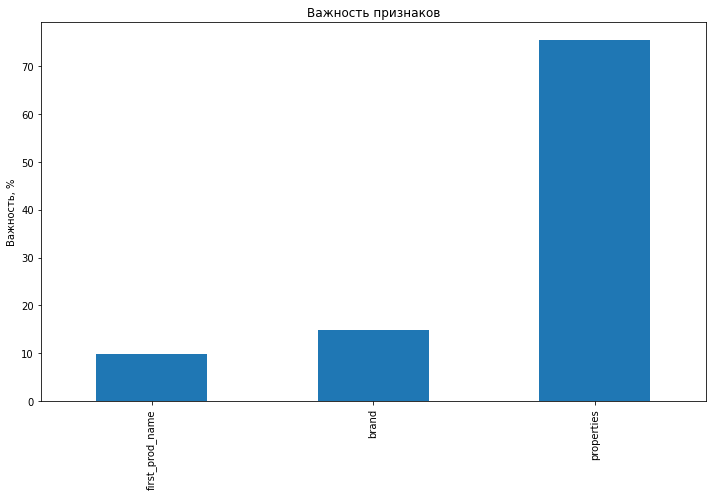

In [72]:
cat_imp = pd.Series(final_model.get_feature_importance(),
                         X_train.columns)
fig, ax = plt.subplots(figsize=(10,7))
cat_imp.plot.bar(ax=ax)
ax.set_title("Важность признаков")
ax.set_ylabel('Важность, %')
fig.tight_layout()

In [ ]:
# Исправление категорий вручную

In [125]:
res_df = new_df.groupby(['product_group_name']).agg({'main_category_name_pred': ['nunique', set]}).reset_index()
# res_sub_df = new_df.groupby(['product_group_name']).agg({'category_name': ['nunique', set]}).reset_index()
# Список продуктов с категорией  Рецепты
res_prod_list = res_df['product_group_name'].values
# res_prod_list_sub = res_sub_df['product_group_name'].values

In [126]:
l = res_df['main_category_name_pred']['set'].values
cat_list = []
for i, j in enumerate(l):
    cat = list(j)
    cat_list.append(cat)

In [127]:
np.unique(cat_list)

C:\Users\druzh\anaconda3\lib\site-packages\numpy\lib\arraysetops.py:270: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ar = np.asanyarray(ar)


array([list(['Автотовары']), list(['Бакалея']),
       list(['Бытовая техника, электроника']),
       list(['Бытовая техника, электроника', 'Бакалея']),
       list(['Бытовая техника, электроника', 'Дача, сад']),
       list(['Бытовая химия, уборка']),
       list(['Бытовая химия, уборка', 'Автотовары']),
       list(['Вода, соки, напитки']),
       list(['Вода, соки, напитки', 'Детские товары']),
       list(['Всё для ремонта']),
       list(['Всё для ремонта', 'Косметика, гигиена']),
       list(['Всё для ремонта', 'Товары для дома']),
       list(['Готовая еда']), list(['Готовая еда', 'Бакалея']),
       list(['Готовая еда', 'Замороженные продукты']),
       list(['Готовая еда', 'Овощи, фрукты, зелень, орехи']),
       list(['Дача, сад']), list(['Дача, сад', 'Бакалея']),
       list(['Дача, сад', 'Кухня']),
       list(['Дача, сад', 'Товары для дома']), list(['Детские товары']),
       list(['Замороженные продукты']), list(['Канцелярия, книги']),
       list(['Канцелярия, книги', 'С

In [144]:
check = res_df.loc[res_df['main_category_name_pred']['set'] == {'Канцелярия, книги', 'Сладости'}, 'product_group_name']
check

85297    patafix uhu белые клеящие подушечки
Name: product_group_name, dtype: object

In [145]:
new_df.loc[new_df['product_group_name'].str.contains('белые клеящие подушечки')]

,product_group_name_orig,product_group_name,index,_id,name_store,main_category_name,main_category_img_url,category_name,category_img_url,category_permalink,...,product_unit_price,product_description,product_description_original,product_properties,manufacturer,brand,properties,product_name_prep_short,product_name_prep,main_category_name_pred
4045,клеящие подушечки patafix uhu белые 80 шт,patafix uhu белые клеящие подушечки,4045,{'$oid': '62b829c99f7c1a6b847bb6b6'},Ашан,"Канцелярия, книги",{'url': 'https://storage.yandexcloud.net/sberm...,Клей,{'url': 'https://storage.yandexcloud.net/sberm...,kantsieliariia/raskhodnyie-kantstovary/kliei,...,129.00,Uhu Клеящие подушечки Тac-Patafix. Многоразовы...,Uhu Клеящие подушечки Тac-Patafix. Многоразовы...,"{'product_ingredients': {}, 'product_nutrition...",Uhu,uhu,клей декоративный,клеящие подушечки patafix белые 80 шт,клеить подушечка patafix белые,Сладости
1214,клеящие подушечки patafix uhu белые 80 шт,patafix uhu белые клеящие подушечки,1214,{'$oid': '62b829529f7c1a6b847baba7'},Метро,"Канцелярия, книги",{'url': 'https://storage.yandexcloud.net/sberm...,Клей,{'url': 'https://storage.yandexcloud.net/sberm...,kantsieliariia/raskhodnyie-kantstovary/kliei,...,231.27,Uhu Клеящие подушечки Тac-Patafix. Многоразовы...,Uhu Клеящие подушечки Тac-Patafix. Многоразовы...,"{'product_ingredients': {}, 'product_nutrition...",Uhu,uhu,клей декоративный,клеящие подушечки patafix белые 80 шт,клеить подушечка patafix белые,Сладости
72190,клеящие подушечки uhu patafix белые 80 шт,patafix uhu белые клеящие подушечки,72225,{'$oid': '62b836569f7c1a6b847cc10a'},Глобус,"Канцтовары, книги, творчество",{'url': 'https://storage.yandexcloud.net/sberm...,Офисная канцелярия,{'url': 'https://storage.yandexcloud.net/sberm...,katalogh-globus/kantstovary-knighi-tvorchiestv...,...,249.99,Uhu Patafix — это средство для быстрого и наде...,Uhu Patafix — это средство для быстрого и наде...,"{'product_ingredients': {}, 'product_nutrition...",UHU GmbH & Co KG,uhu,клейкие ленты канцелярские,клеящие подушечки patafix белые 80 шт,клеить подушечка patafix белые,"Канцелярия, книги"


In [63]:
# Исправление категории
for i in check:
    new_df.loc[new_df['product_group_name'].str.contains(i), 'main_category_name'] = 'Хлеб, выпечка'

In [8]:
# Чтение из файла окончательного тренировочного датасета
df_train = pd.read_csv(DATASET_PATH)
df_train.head()

,product_price,total_weight_kg,total_weight_flag,main_category_name,brand,manufacturer,properties,first_prod_name,second_prod_name,last_name,eng_name
0,168.99,0.0,1,Всё для ремонта,KRONA,Химик ОАО,Очистители,обезжириватель,очистка,раствор,krona
1,279.00,0.0,1,Всё для ремонта,"То, что надо!",Окей ООО,Тросы,трос,прочистка,труба,-
2,89.99,0.5,0,Всё для ремонта,KRONA,KRONA,Растворители,обезжириватель,-,-,krona
3,168.99,0.0,1,Всё для ремонта,Химик,Химик ОАО,Растворители,керосин,химик,химик,-
4,126.99,0.0,1,Всё для ремонта,Fit,Технопласт ООО,Очки,очки,защитный,прозрачный,fit


In [63]:
# load the model from disk
model = pickle.load(open(MODEL_FILE_PATH, 'rb'))
# result = loaded_model.score(X_test, y_test)

In [17]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# model.plot_tree(
#     tree_idx=6,
#     pool=train_dataset)

In [18]:
# Дообучение модели???
model_3 = CatBoostClassifier(
    iterations=50,
    cat_features=CAT_FEATURE_NAMES)
model_3.fit( X_train, y_train,  init_model=model)

Learning rate set to 0.5
0:	learn: 0.0898411	total: 1.53s	remaining: 1m 14s
1:	learn: 0.0868951	total: 2.78s	remaining: 1m 6s
2:	learn: 0.0841046	total: 4.11s	remaining: 1m 4s
3:	learn: 0.0825519	total: 5.34s	remaining: 1m 1s
4:	learn: 0.0806888	total: 6.61s	remaining: 59.5s
5:	learn: 0.0795183	total: 7.84s	remaining: 57.5s
6:	learn: 0.0780613	total: 9.06s	remaining: 55.7s
7:	learn: 0.0772444	total: 10.3s	remaining: 53.9s
8:	learn: 0.0757709	total: 11.5s	remaining: 52.3s
9:	learn: 0.0745262	total: 12.8s	remaining: 51.1s
10:	learn: 0.0732352	total: 14s	remaining: 49.6s
11:	learn: 0.0721779	total: 15.2s	remaining: 48.2s
12:	learn: 0.0712571	total: 16.4s	remaining: 46.8s
13:	learn: 0.0705066	total: 17.7s	remaining: 45.5s
14:	learn: 0.0696248	total: 18.9s	remaining: 44.2s
15:	learn: 0.0688317	total: 20.2s	remaining: 43s
16:	learn: 0.0678381	total: 21.5s	remaining: 41.6s
17:	learn: 0.0666859	total: 22.7s	remaining: 40.3s
18:	learn: 0.0659409	total: 23.9s	remaining: 39s
19:	learn: 0.0653148	

In [23]:
evaluate_preds(model_3, X_train, X_test, y_train, y_test)

TRAIN

                                                precision    recall  f1-score   support

                                    Автотовары       0.99      0.99      0.99       351
                                       Бакалея       0.99      1.00      1.00       750
                  Бытовая техника, электроника       0.99      1.00      0.99       515
                         Бытовая химия, уборка       0.96      0.99      0.98       577
                           Вода, соки, напитки       0.96      0.97      0.97       601
                               Всё для ремонта       1.00      1.00      1.00       224
                                   Готовая еда       0.96      0.91      0.93       125
                                     Дача, сад       0.97      0.99      0.98      1120
                                Детские товары       0.98      0.93      0.95      1981
                         Замороженные продукты       0.96      0.96      0.96       547
                        